In [ ]:
import yfinance as yf
import pandas as pd
import requests
import json
import os
from backtesting import Strategy, Backtest
import backtrader as bt
from backtrader import Indicator
import backtrader.analyzers as btanalyzers
import numpy as np

from datetime import datetime, timedelta
import os.path
import sys

import matplotlib
import matplotlib.pyplot as plt

ModuleNotFoundError: No module named 'yfinance'

In [ ]:
import yfinance as yf
import pandas as pd

# Download SPY data from Yahoo Finance for the maximum period available
spy_data = yf.download('SPY', start="1900-01-01", end=None)  # Start date set early to get as much data as possible


# Save the sorted data to a CSV file
spy_data.to_csv('Data/SPY.csv', index=False)

print("SPY data saved to 'SPY.csv'")


[*********************100%***********************]  1 of 1 completed

SPY data saved to 'SPY.csv'


In [2]:
spy_data.head()

Price,Adj Close,Close,High,Low,Open,Volume
Ticker,SPY,SPY,SPY,SPY,SPY,SPY
Date,,,,,,
1993-01-29 00:00:00+00:00,24.608622,43.93750,43.96875,43.75000,43.96875,1003200
1993-02-01 00:00:00+00:00,24.783640,44.25000,44.25000,43.96875,43.96875,480500
1993-02-02 00:00:00+00:00,24.836151,44.34375,44.37500,44.12500,44.21875,201300
1993-02-03 00:00:00+00:00,25.098698,44.81250,44.84375,44.37500,44.40625,529400
1993-02-04 00:00:00+00:00,25.203716,45.00000,45.09375,44.46875,44.96875,531500


In [3]:
%matplotlib inline

In [ ]:
usdeur = yf.Ticker("USDEUR=X")
usdeur.history()

In [2]:
import yfinance as yf
from datetime import datetime, timedelta
import pandas as pd
import os

# List of 10 forex currency pairs involving USD
symbols = [
    "USDEUR=X",  # Euro / US Dollar
    "USDGBP=X",  # British Pound / US Dollar
    "USDJPY=X",  # US Dollar / Japanese Yen
    "USDCHF=X",  # US Dollar / Swiss Franc
    "USDAUD=X",  # Australian Dollar / US Dollar
    "USDCAD=X",  # US Dollar / Canadian Dollar
    "USDNZD=X",  # New Zealand Dollar / US Dollar
    "USDSEK=X",  # US Dollar / Swedish Krona
    "USDMXN=X",  # US Dollar / Mexican Peso
    "USDHKD=X"   # US Dollar / Hong Kong Dollar
]

# Loop over each symbol
for symbol in symbols:
    # Initialize an empty list to store data chunks
    data_list = []
    
    # Define the end date as today
    end_date = datetime.now()
    
    # Define the start date as 730 days before the end date
    start_date = end_date - timedelta(days=729)
    
    # Set the current end date to the overall end date
    current_end = end_date
    
    # Loop to download data in 60-day chunks
    while current_end > start_date:
        current_start = current_end - timedelta(days=60)
        if current_start < start_date:
            current_start = start_date  # Adjust if the chunk overlaps the start date
        print(f"Downloading data for {symbol} from {current_start.date()} to {current_end.date()}")
        data_chunk = yf.download(
            symbol,
            start=current_start.strftime('%Y-%m-%d'),
            end=current_end.strftime('%Y-%m-%d'),
            interval="1h",
            progress=False
        )
        data_list.append(data_chunk)
        current_end = current_start  # Move the window back
    
    # Concatenate all data chunks into a single DataFrame
    data = pd.concat(data_list)
    
    # Remove duplicate indices if any
    data = data[~data.index.duplicated(keep='first')]
    
    # Reset the index to ensure it's clean
    data.reset_index(inplace=True)
    
    # Construct the filename based on the symbol
    # For example, 'EURUSD=X' becomes 'forex_eurusd_1h.csv'
    symbol_name = symbol.replace('=X', '').lower()
    filename = f"Data/forex_{symbol_name}_1h_2.csv"
    
    # Save the DataFrame to CSV
    data.to_csv(filename, index=False)
    
    # Optional: Display a message after saving
    print(f"Data for {symbol} saved to {filename}\n")



Data for USDEUR=X saved to Data/forex_usdeur_1h_2.csv

Data for USDGBP=X saved to Data/forex_usdgbp_1h_2.csv

Data for USDJPY=X saved to Data/forex_usdjpy_1h_2.csv

Data for USDCHF=X saved to Data/forex_usdchf_1h_2.csv

Data for USDAUD=X saved to Data/forex_usdaud_1h_2.csv

Data for USDCAD=X saved to Data/forex_usdcad_1h_2.csv

Data for USDNZD=X saved to Data/forex_usdnzd_1h_2.csv

Data for USDSEK=X saved to Data/forex_usdsek_1h_2.csv

Data for USDMXN=X saved to Data/forex_usdmxn_1h_2.csv

Data for USDHKD=X saved to Data/forex_usdhkd_1h_2.csv



In [3]:
# Read csv into a dataframe
usdeur = pd.read_csv("usdeur.csv")
usdeur["Date"] = pd.to_datetime(usdeur["Date"])
usdeur = usdeur.set_index("Date")

sandp500 = pd.read_csv("sandp500.csv")
sandp500["Date"] = pd.to_datetime(sandp500["Date"])
sandp500 = sandp500.set_index("Date")

spy = pd.read_csv("SPY.csv")
spy["Date"] = pd.to_datetime(spy["Date"])
spy = spy.set_index("Date")

In [11]:
def print_results(results):
  #, data, start_cash=100000, start_date=datetime(1993, 1, 29), end_date=datetime(2024, 6, 14)
  trade_stats = results.analyzers.trade_stats.get_analysis()
  drawdown_stats = results.analyzers.drawdown.get_analysis()

  # Print trade statistics
  print("Trade Stats:")
  print(f"Total trades: {trade_stats.total.closed}")
  print(f"Winning trades: {trade_stats.won.total}")
  print(f"Losing trades: {trade_stats.lost.total}")
  print(f"Time in market: {results.in_market / results.total_bars * 100:.2f}%")
  print(f"Average percent gain: {results.total_percent_gain / trade_stats.total.closed:.2f}%")
  print(f"Profit factor: {results.total_gain / results.total_loss:.1f}")

  # Print drawdown statistics
  print("\nDrawdown Stats:")
  print(f"Max Drawdown: {drawdown_stats.max.drawdown:.2f}%")
  print(f"Max Drawdown Duration: {drawdown_stats.max.len} bars")

  returns = results.analyzers.returns.get_analysis()

  print("\nStrategy Return Stats:")
  print(f"Total Return: {returns['rtot'] * 100:.2f}%")
  print(f"Annualized Return: {returns['rnorm'] * 100:.2f}%")
  print(f"Risk adjusted return: {(returns['rnorm']) / (results.in_market / results.total_bars)*100:.2f}%")

  # buy_and_hold_return = (data["Close"].iloc[-1] - data["Close"].iloc[0]) / data["Close"].iloc[0] * 100

  # print("\nBuy-and-Hold Performance:")
  # print(f"Buy-and-Hold Return: {buy_and_hold_return:.2f}%")

  # n_years = (end_date - start_date).days / 365.25
  # initial_price = data.iloc[0]["Adj Close"]
  # final_price = data.iloc[-1]["Adj Close"]
  # end_cash_bh = start_cash * (final_price / initial_price)
  # cagr_bh = (end_cash_bh / start_cash) ** (1 / n_years) - 1
  # print(f'\nCAGR of Buy and Hold: {cagr_bh:.2%}')

## Backtesting SPY

In [154]:
import backtrader as bt

# Copied from Backtrader for modification because it is not the same as strategy
# I am copying
class WilliamsR(Indicator):
    '''
    Developed by Larry Williams to show the relation of closing prices to
    the highest-lowest range of a given period.

    Known as Williams %R (but % is not allowed in Python identifiers)

    Formula:
      - num = highest_period - close
      - den = highestg_period - lowest_period
      - percR = (num / den) * -100.0

    See:
      - http://en.wikipedia.org/wiki/Williams_%25R
    '''
    lines = ('percR',)
    params = (('period', 2),
              ('upperband', -20.0),
              ('lowerband', -80.0),)

    plotinfo = dict(plotname='Williams R%')
    plotlines = dict(percR=dict(_name='R%'))

    def _plotinif(self):
        self.plotinfo.plotyhlines = [self.p.upperband, self.p.lowerband]

    def __init__(self):
        h = bt.indicators.Highest(self.data.high, period=self.p.period)
        l = bt.indicators.Lowest(self.data.low, period=self.p.period)
        c = self.data.close

        self.lines.percR = -100.0 * (h - c) / (h - l)

        super(WilliamsR, self).__init__()

bt.indicators.WilliamsR

# Some of this class was assisted using codeium autocomplete
class WilliamsRStrategy(bt.Strategy):
    params = (('period', 2),
              ('upperband', -20.0),
              ('lowerband', -80.0),
              ('cheat_on_open', False),)

    def log(self, txt, dt=None):
        ''' Logging function for this strategy'''
        dt = dt or self.datas[0].datetime.date(0)
        print('%s, %s' % (dt.isoformat(), txt))

    def __init__(self):
        # Initialize Williams %R indicator
        self.williams_r = WilliamsR(self.datas[0], period=self.p.period, lowerband=self.p.lowerband, upperband=self.p.upperband)
        self.equity_curve = []
        self.buy_and_hold = []
        self.dates = []

        self.dataclose = self.datas[0].close
        self.datahigh = self.datas[0].high

        self.in_market = 0
        self.total_bars = 0

        self.total_percent_gain = 0
        self.total_gain = 0
        self.total_loss = 0

        self.buy_flag = False

    def notify_trade(self, trade):
        if trade.isclosed:
            percent_gain = (trade.pnl / self.cash) * 100
            self.total_percent_gain += percent_gain
            if trade.pnl > 0:
                self.total_gain += trade.pnl
            else:
                self.total_loss += -trade.pnl

    def notify_order(self, order):
        if order.status in [order.Submitted, order.Accepted]:
            # Buy/Sell order submitted/accepted to/by broker - Nothing to do
            return

        # Check if an order has been completed
        # Attention: broker could reject order if not enough cash
        if order.status in [order.Completed]:
            if order.isbuy():
                self.log('BUY EXECUTED, %.2f' % order.executed.price)
            elif order.issell():
                self.log('SELL EXECUTED, %.2f' % order.executed.price)

            self.bar_executed = len(self)
        elif order.status == order.Canceled:
            if order.isbuy():
                self.log(f'Buy Order Canceled')
            else:
                self.log(f'Sell Order Canceled')
        elif order.status == order.Margin:
            if order.isbuy():
                self.log(f'Buy Order Margin')
            else:
                self.log(f'Sell Order Margin')

        elif order.status == order.Rejected:
            if order.isbuy():
                self.log(f'Buy Order Rejected')
            else:
                self.log(f'Sell Order Rejected')

        # Write down: no pending order
        self.order = None

    
    def next(self):
        self.equity_curve.append(self.broker.getvalue())
        self.dates.append(self.datas[0].datetime[0])

        self.total_bars += 1

        if not self.p.cheat_on_open:
            if not self.position:  # Not in the market
                if self.williams_r <= self.williams_r.p.lowerband:
                    self.cash = self.broker.getcash()
                    next_day_open = self.data.close[0]
                    size_to_buy = int(self.cash / next_day_open)
                    self.buy(exectype=bt.Order.Market, size=size_to_buy)

        if self.position:
            self.in_market += 1
            if self.williams_r.lines.percR[0] >= self.williams_r.p.upperband or self.datas[0].close[0] >= self.datas[0].high[-1]:
                self.close()
    
    def next_open(self):
        if not self.position:  # Not in the market
            if self.williams_r.lines.percR[0] <= self.williams_r.p.lowerband:
                self.cash = self.broker.getcash()
                next_day_open = self.data.open[0]
                size_to_buy = int(self.cash / next_day_open)
                self.buy(exectype=bt.Order.Market, size=size_to_buy)

In [32]:
# Create a cerebro engine instance
cerebro = bt.Cerebro(cheat_on_open=False)
start_date = datetime(1993, 1, 29)
end_date = datetime(2024, 6, 14)
data = bt.feeds.YahooFinanceCSVData(dataname='SPY.csv', fromdate=start_date, todate=end_date, adjclose=True, round=False)
cerebro.adddata(data)

# Add the WilliamsR strategy
cerebro.addstrategy(WilliamsRStrategy, period=2, upperband=-30.0, lowerband=-90.0)
cerebro.broker.setcommission(commission=0.0)
cerebro.broker.set_coc(True)

# Set initial capital and broker settings
# This code was assited using Codeium autocomplete
start_cash = 100000.0000
cerebro.broker.setcash(start_cash)
cerebro.addsizer(bt.sizers.PercentSizer, percents=100)
cerebro.addanalyzer(btanalyzers.TradeAnalyzer, _name="trade_stats")
cerebro.addanalyzer(btanalyzers.DrawDown, _name="drawdown")
cerebro.addanalyzer(btanalyzers.Returns, _name="returns")

# Print starting capital
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run the strategy
close_results = cerebro.run()

# Print final capital
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 100000.00
1993-02-16, BUY EXECUTED, 24.98
1993-02-23, SELL EXECUTED, 24.49
1993-03-05, BUY EXECUTED, 25.13
1993-03-09, SELL EXECUTED, 25.62
1993-03-22, BUY EXECUTED, 25.34
1993-03-24, SELL EXECUTED, 25.25
1993-04-05, BUY EXECUTED, 24.81
1993-04-08, SELL EXECUTED, 24.95
1993-04-20, BUY EXECUTED, 25.18
1993-04-28, SELL EXECUTED, 24.69
1993-05-07, BUY EXECUTED, 25.01
1993-05-12, SELL EXECUTED, 25.11
1993-05-14, BUY EXECUTED, 24.78
1993-05-18, SELL EXECUTED, 24.85
1993-05-24, BUY EXECUTED, 25.18
1993-05-27, SELL EXECUTED, 25.66
1993-06-09, BUY EXECUTED, 25.16
1993-06-14, SELL EXECUTED, 25.38
1993-06-16, BUY EXECUTED, 25.29
1993-06-17, SELL EXECUTED, 25.34
1993-06-21, BUY EXECUTED, 25.22
1993-06-23, SELL EXECUTED, 25.29
1993-06-24, BUY EXECUTED, 25.06
1993-06-25, SELL EXECUTED, 25.40
1993-07-07, BUY EXECUTED, 25.06
1993-07-09, SELL EXECUTED, 25.41
1993-07-23, BUY EXECUTED, 25.22
1993-07-26, SELL EXECUTED, 25.34
1993-09-21, BUY EXECUTED, 25.91
1993-09-23, SELL EXECU

In [33]:
# Create a cerebro engine instance
cerebro = bt.Cerebro(cheat_on_open=True)
start_date = datetime(1993, 1, 29)
end_date = datetime(2024, 6, 14)
data = bt.feeds.YahooFinanceCSVData(dataname='SPY.csv', fromdate=start_date, todate=end_date, adjclose=True, round=False)
cerebro.adddata(data)

# Add the WilliamsR strategy
cerebro.addstrategy(WilliamsRStrategy, period=2, upperband=-30.0, lowerband=-90.0, cheat_on_open=True)
cerebro.broker.setcommission(commission=0.0)
cerebro.broker.set_coc(False)

# Set initial capital and broker settings
# This code was assited using Codeium autocomplete
start_cash = 100000.0000
cerebro.broker.setcash(start_cash)
cerebro.addsizer(bt.sizers.PercentSizer, percents=100)
cerebro.addanalyzer(btanalyzers.TradeAnalyzer, _name="trade_stats")
cerebro.addanalyzer(btanalyzers.DrawDown, _name="drawdown")
cerebro.addanalyzer(btanalyzers.Returns, _name="returns")

# Print starting capital
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run the strategy
open_results = cerebro.run()

# Print final capital
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 100000.00
1993-02-16, BUY EXECUTED, 24.91
1993-02-23, SELL EXECUTED, 24.56
1993-03-05, BUY EXECUTED, 25.17
1993-03-09, SELL EXECUTED, 25.57
1993-03-22, BUY EXECUTED, 25.09
1993-03-24, SELL EXECUTED, 25.22
1993-04-05, BUY EXECUTED, 25.01
1993-04-08, SELL EXECUTED, 25.06
1993-04-20, BUY EXECUTED, 25.15
1993-04-28, SELL EXECUTED, 24.65
1993-05-07, BUY EXECUTED, 25.02
1993-05-12, SELL EXECUTED, 25.01
1993-05-14, BUY EXECUTED, 24.78
1993-05-18, SELL EXECUTED, 24.87
1993-05-24, BUY EXECUTED, 25.23
1993-05-27, SELL EXECUTED, 25.69
1993-06-09, BUY EXECUTED, 25.25
1993-06-14, SELL EXECUTED, 25.41
1993-06-16, BUY EXECUTED, 25.29
1993-06-17, SELL EXECUTED, 25.39
1993-06-21, BUY EXECUTED, 25.29
1993-06-23, SELL EXECUTED, 25.29
1993-06-24, BUY EXECUTED, 25.13
1993-06-25, SELL EXECUTED, 25.38
1993-07-07, BUY EXECUTED, 25.04
1993-07-09, SELL EXECUTED, 25.41
1993-07-23, BUY EXECUTED, 25.27
1993-07-26, SELL EXECUTED, 25.41
1993-09-21, BUY EXECUTED, 25.95
1993-09-23, SELL EXECU

In [35]:
print_results(open_results[0], spy, start_cash=start_cash, start_date=start_date, end_date=end_date)

Trade Stats:
Total trades: 601
Winning trades: 446
Losing trades: 155
Time in market: 22.31%
Average percent gain: 0.54%
Profit factor: 1.9

Drawdown Stats:
Max Drawdown: 19.29%
Max Drawdown Duration: 477 bars

Strategy Return Stats:
Total Return: 309.96%
Annualized Return: 10.39%
Risk adjusted return: 46.59%

Buy-and-Hold Performance:
Buy-and-Hold Return: 1196.60%

CAGR of Buy and Hold: 10.53%


In [37]:
print_results(close_results[0], spy, start_cash=start_cash, start_date=start_date, end_date=end_date)

Trade Stats:
Total trades: 601
Winning trades: 430
Losing trades: 171
Time in market: 22.31%
Average percent gain: 0.59%
Profit factor: 2.4

Drawdown Stats:
Max Drawdown: 16.79%
Max Drawdown Duration: 469 bars

Strategy Return Stats:
Total Return: 344.51%
Annualized Return: 11.62%
Risk adjusted return: 52.07%

Buy-and-Hold Performance:
Buy-and-Hold Return: 1196.60%

CAGR of Buy and Hold: 10.53%


In [38]:
# Plot the result
# matplotlib.rcParams['figure.figsize'] = [20, 10]
# cerebro.plot(iplot=False)

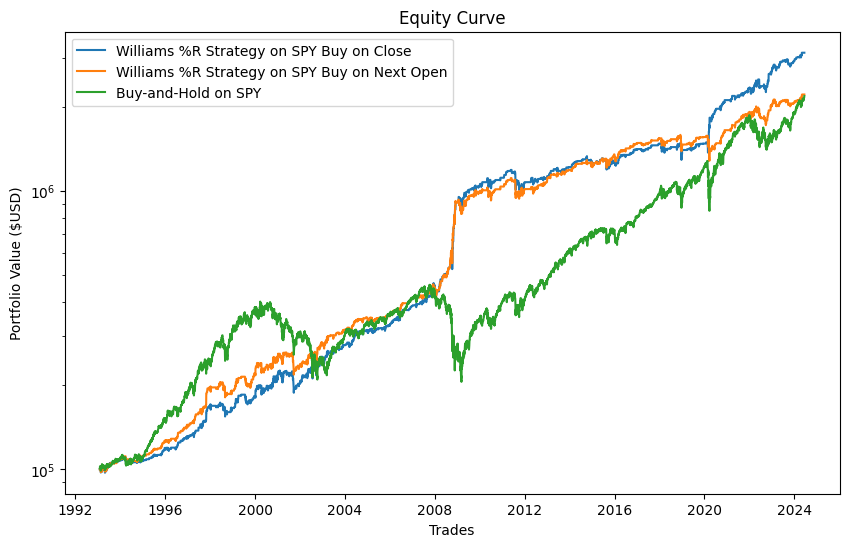

In [60]:
# Some of this code was assisted by Codeium autocomplete
close_strategy = close_results[0]
dates = close_strategy.dates
open_strategy = open_results[0]

spy_rows = spy.loc[spy.index.isin(np.array(dates, dtype='datetime64[ns]'))]
spy_rows = spy.reindex(dates, method='ffill')
shares = start_cash / spy.iloc[0]["Adj Close"]
buy_and_hold_spy = [shares * row["Adj Close"] for _, row in spy_rows.iterrows()]

plt.figure(figsize=(10, 6))
plt.plot(dates, close_strategy.equity_curve, label='Williams %R Strategy on SPY Buy on Close')
plt.plot(dates, open_strategy.equity_curve, label='Williams %R Strategy on SPY Buy on Next Open')
plt.plot(dates, buy_and_hold_spy, label='Buy-and-Hold on SPY')
y_ticks = [200000,500000,1000000,4000000] # Adjust the step as needed
# Define custom labels
y_labels = []
for val in y_ticks:
    if val < 1_000_000:
        y_labels.append(f'{int(val):,}')
    else:
        y_labels.append(f'{int(val/1_000_000)}M')

# Set the y-ticks and labels
plt.yticks(y_ticks, y_labels)
plt.title('Equity Curve')
plt.xlabel('Trades')
plt.ylabel('Portfolio Value ($USD)')

plt.yscale('log')
plt.legend()
plt.show()

## Optimization Universe

In [7]:
def get_strat_info(strat):
  trade_stats = strat.analyzers.trade_stats.get_analysis()
  drawdown_stats = strat.analyzers.drawdown.get_analysis()

  # Print trade statistics
  print("Trade Stats:")
  print(f"Total trades: {trade_stats.total.closed}")
  print(f"Winning trades: {trade_stats.won.total}")
  print(f"Losing trades: {trade_stats.lost.total}")
  print(f"Time in market: {strat.in_market / strat.total_bars * 100:.2f}%")
  print(f"Average percent gain: {strat.total_percent_gain / trade_stats.total.closed:.2f}%")
  print(f"Profit factor: {strat.total_gain / strat.total_loss:.1f}")

  # Print drawdown statistics
  print("\nDrawdown Stats:")
  print(f"Max Drawdown: {drawdown_stats.max.drawdown:.2f}%")
  print(f"Max Drawdown Duration: {drawdown_stats.max.len} bars")

  returns = strat.analyzers.returns.get_analysis()

  print("\nStrategy Return Stats:")
  print(f"Total Return: {returns['rtot'] * 100:.2f}%")
  print(f"Annualized Return: {returns['rnorm'] * 100:.2f}%")
  print(f"Risk adjusted return: {(returns['rnorm']) / (strat.in_market / strat.total_bars)*100:.2f}%")

  buy_and_hold_return = (spy["Close"].iloc[-1] - spy["Close"].iloc[0]) / spy["Close"].iloc[0] * 100

  print("\nBuy-and-Hold Performance:")
  print(f"Buy-and-Hold Return: {buy_and_hold_return:.2f}%")

  n_years = (end_date - start_date).days / 365.25
  initial_price = spy.iloc[0].Close
  final_price = spy.iloc[-1].Close
  end_cash_bh = start_cash * (final_price / initial_price)
  cagr_bh = (end_cash_bh / start_cash) ** (1 / n_years) - 1
  print(f'CAGR of Buy and Hold: {cagr_bh:.2%}')

In [63]:
periods = list(range(2,21))
upperbands = list(range(-10,-35,-5))
lowerbands = list(range(-70,-95,-5))

cerebro = bt.Cerebro(cheat_on_open=True)
start_date = datetime(1993, 1, 29)
end_date = datetime(2024, 6, 14)
data = bt.feeds.YahooFinanceCSVData(dataname='SPY.csv', fromdate=start_date, todate=end_date, adjclose=True, round=False)
cerebro.adddata(data)

# Add the WilliamsR strategy
cerebro.optstrategy(WilliamsRStrategy, period=periods, upperband=upperbands, lowerband=lowerbands, cheat_on_open=True)

# Set initial capital and broker settings
# This code was assited using Codeium autocomplete
start_cash = 100000.0
cerebro.broker.setcash(start_cash)
cerebro.addsizer(bt.sizers.AllInSizer)
cerebro.addanalyzer(btanalyzers.TradeAnalyzer, _name="trade_stats")
cerebro.addanalyzer(btanalyzers.DrawDown, _name="drawdown")
cerebro.addanalyzer(btanalyzers.Returns, _name="returns")

runs = cerebro.run(maxcpus=1)

In [65]:
for run in runs:
  for strat in run:
    print(f'Period: {strat.params.period}, Upper Band: {strat.params.upperband}, Lower Band: {strat.params.lowerband}')
    returns = strat.analyzers.returns.get_analysis()

Period: 2, Upper Band: -10, Lower Band: -70
Period: 2, Upper Band: -10, Lower Band: -75
Period: 2, Upper Band: -10, Lower Band: -80
Period: 2, Upper Band: -10, Lower Band: -85
Period: 2, Upper Band: -10, Lower Band: -90
Period: 2, Upper Band: -15, Lower Band: -70
Period: 2, Upper Band: -15, Lower Band: -75
Period: 2, Upper Band: -15, Lower Band: -80
Period: 2, Upper Band: -15, Lower Band: -85
Period: 2, Upper Band: -15, Lower Band: -90
Period: 2, Upper Band: -20, Lower Band: -70
Period: 2, Upper Band: -20, Lower Band: -75
Period: 2, Upper Band: -20, Lower Band: -80
Period: 2, Upper Band: -20, Lower Band: -85
Period: 2, Upper Band: -20, Lower Band: -90
Period: 2, Upper Band: -25, Lower Band: -70
Period: 2, Upper Band: -25, Lower Band: -75
Period: 2, Upper Band: -25, Lower Band: -80
Period: 2, Upper Band: -25, Lower Band: -85
Period: 2, Upper Band: -25, Lower Band: -90
Period: 2, Upper Band: -30, Lower Band: -70
Period: 2, Upper Band: -30, Lower Band: -75
Period: 2, Upper Band: -30, Lowe

In [66]:
from scipy.interpolate import griddata

def plot_op_uni(upperbands, lowerbands, profit, period):
  grid_x, grid_y = np.meshgrid(
      np.linspace(min(upperbands), max(upperbands), 100),
      np.linspace(min(lowerbands), max(lowerbands), 100)
  )

  # Interpolate Z values (profit) for the grid
  grid_z = griddata((upperbands, lowerbands), profit, (grid_x, grid_y), method='cubic')
  flattened_array = [item for sublist in grid_z for item in sublist]
  
  print("Avg Profit: ", sum(flattened_array) / len(flattened_array))

  # Create a figure and 3D axis
  fig = plt.figure()
  ax = fig.add_subplot(111, projection='3d')

  # Plot the surface
  surf = ax.plot_surface(grid_x, grid_y, grid_z, cmap='viridis', edgecolor='none')

  # Add color bar for heatmap
  fig.colorbar(surf, ax=ax, shrink=0.5, aspect=5)

  # Labels
  ax.set_title(f'Optimization Universe for a Period of {period}')
  ax.set_xlabel('Upper Bands')
  ax.set_ylabel('Lower Bands')
  ax.set_zlabel('Profit')

  # Show the plot
  plt.show()

Avg Profit:  11.099486916113683


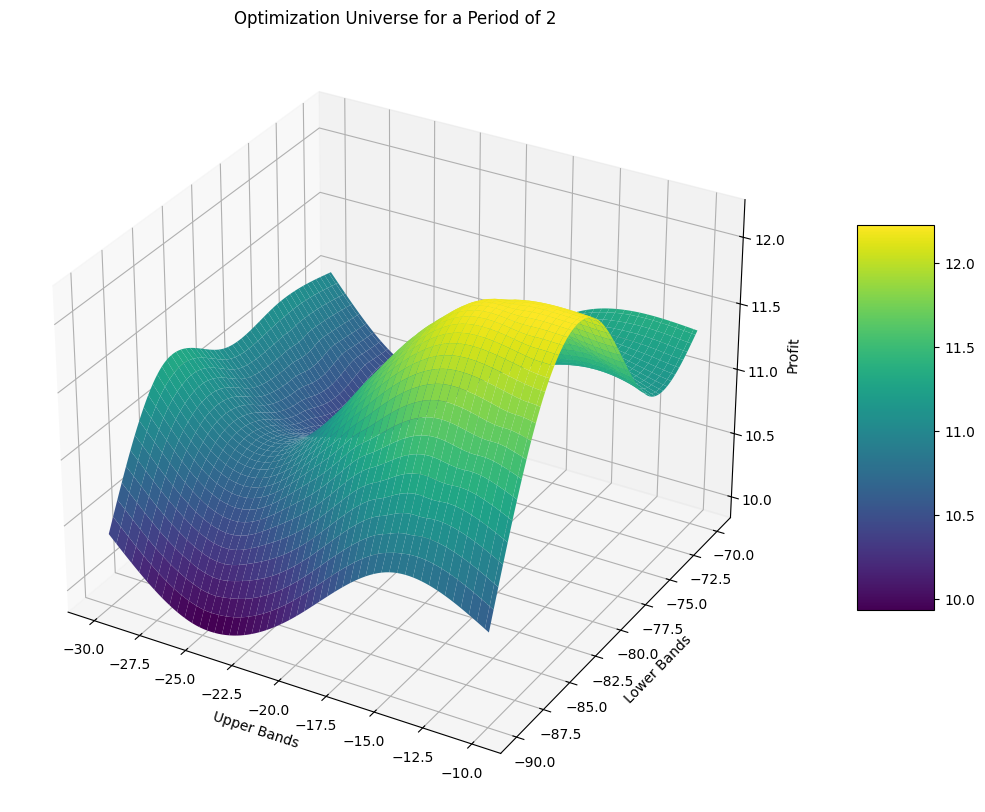

Avg Profit:  9.171153551786656


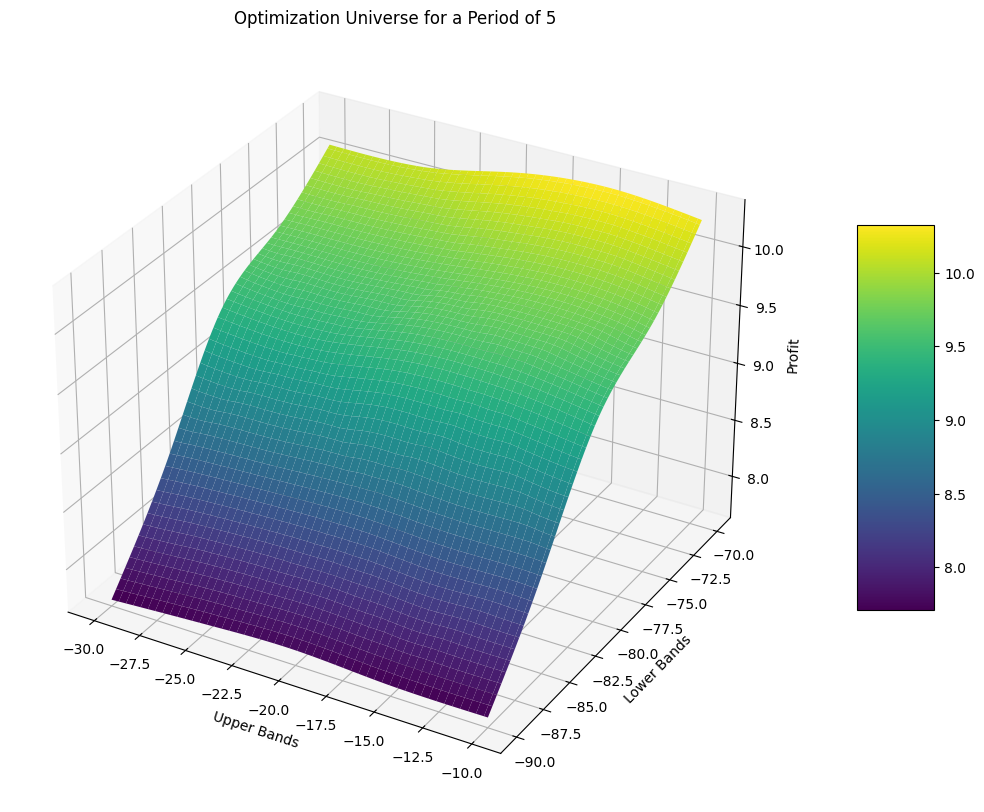

Avg Profit:  8.400120593862765


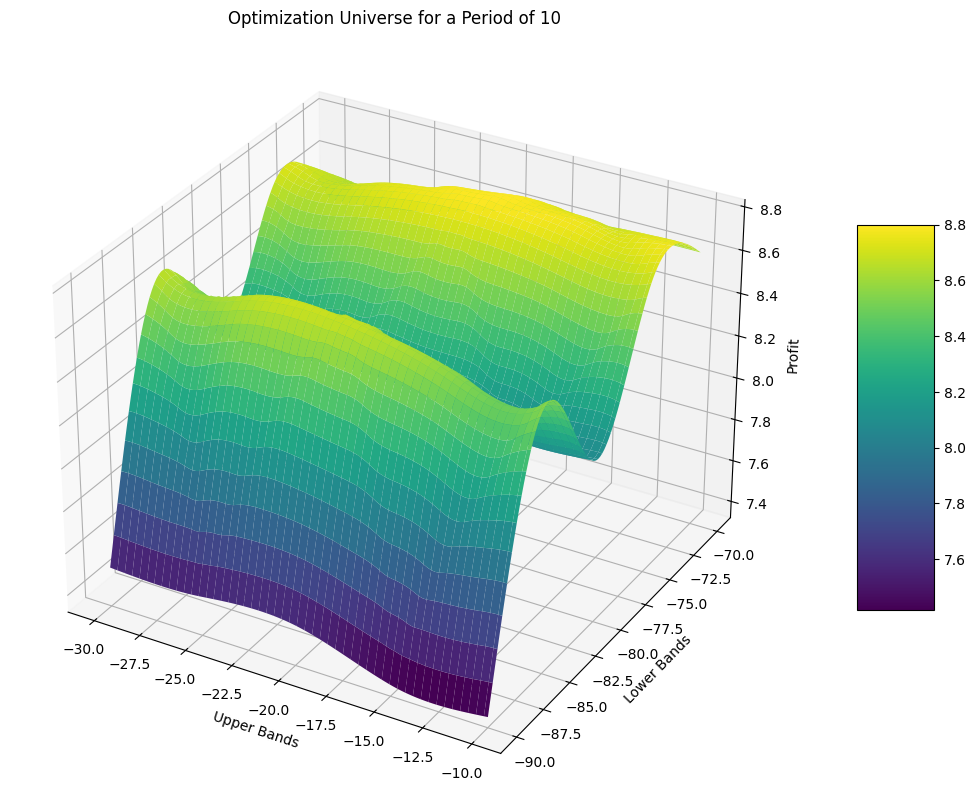

Avg Profit:  6.572013836772654


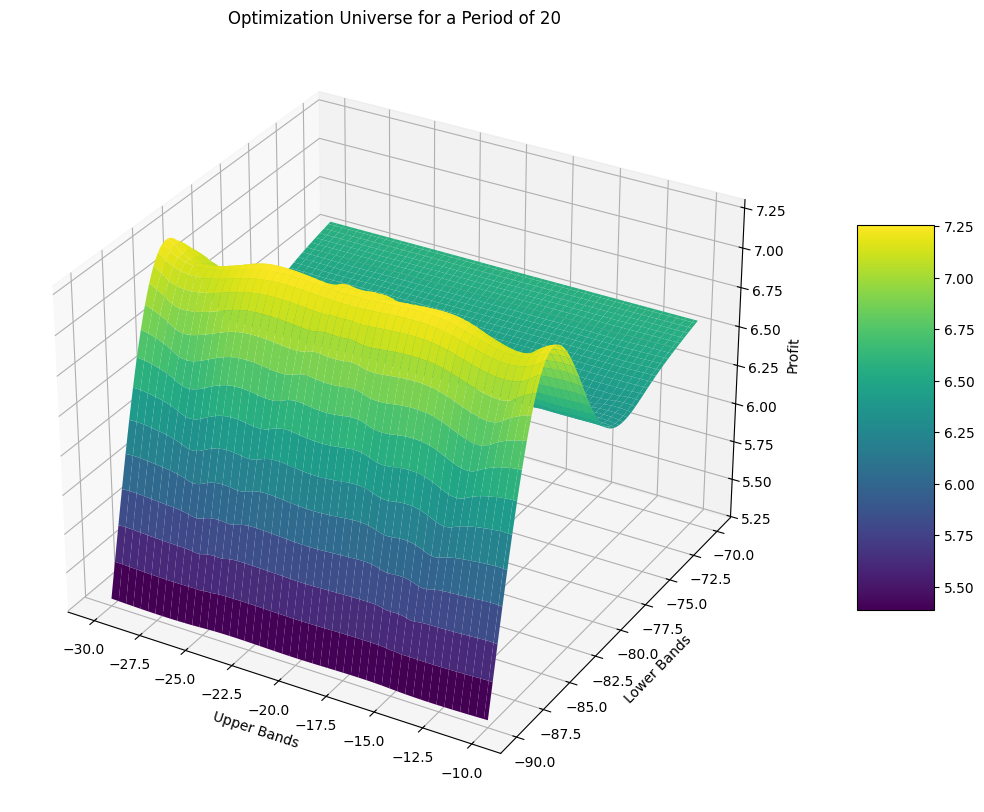

In [67]:
for period in [2,5,10,20]:
  upperbands = [strat[0].params.upperband for strat in runs if strat[0].params.period == period]
  lowerbands = [strat[0].params.lowerband for strat in runs if strat[0].params.period == period]
  profit = [strat[0].analyzers.returns.get_analysis()['rnorm']*100 for strat in runs if strat[0].params.period == period]
  plot_op_uni(upperbands, lowerbands, profit, period)

In [69]:
avg_profits = []
for period in list(range(2,21)):
  profit = [strat[0].analyzers.returns.get_analysis()['rnorm']*100 for strat in runs if strat[0].params.period == period]
  avg_profits.append(sum(profit)/len(profit))

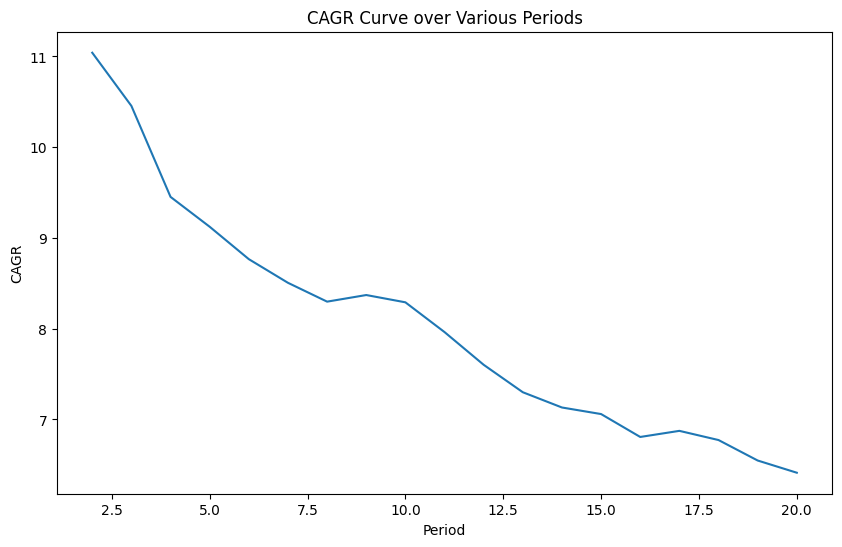

In [70]:
plt.figure(figsize=(10, 6))
plt.plot(list(range(2,21)), avg_profits)
plt.title('CAGR Curve over Various Periods')
plt.xlabel('Period')
plt.ylabel('CAGR')
plt.show()

In [71]:
# Create a cerebro engine instance
cerebro = bt.Cerebro(cheat_on_open=True)
start_date = datetime(1993, 1, 29)
end_date = datetime(2024, 6, 14)
data = bt.feeds.YahooFinanceCSVData(dataname='SPY.csv', fromdate=start_date, todate=end_date, adjclose=True, round=False)
cerebro.adddata(data)

# Add the WilliamsR strategy
cerebro.addstrategy(WilliamsRStrategy, period=2, upperband=-12.5, lowerband=-72.5, cheat_on_open=True)
cerebro.broker.setcommission(commission=0.0)
cerebro.broker.set_coc(False)

# Set initial capital and broker settings
# This code was assited using Codeium autocomplete
start_cash = 100000.0000
cerebro.broker.setcash(start_cash)
cerebro.addsizer(bt.sizers.PercentSizer, percents=100)
cerebro.addanalyzer(btanalyzers.TradeAnalyzer, _name="trade_stats")
cerebro.addanalyzer(btanalyzers.DrawDown, _name="drawdown")
cerebro.addanalyzer(btanalyzers.Returns, _name="returns")

# Print starting capital
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run the strategy
results = cerebro.run()

# Print final capital
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 100000.00
Final Portfolio Value: 3258924.94


In [72]:
print_results(results[0], spy, start_cash=start_cash, start_date=start_date, end_date=end_date)

Trade Stats:
Total trades: 941
Winning trades: 657
Losing trades: 284
Time in market: 41.98%
Average percent gain: 0.39%
Profit factor: 1.7

Drawdown Stats:
Max Drawdown: 24.39%
Max Drawdown Duration: 483 bars

Strategy Return Stats:
Total Return: 348.40%
Annualized Return: 11.75%
Risk adjusted return: 28.00%

Buy-and-Hold Performance:
Buy-and-Hold Return: 1196.60%

CAGR of Buy and Hold: 10.53%


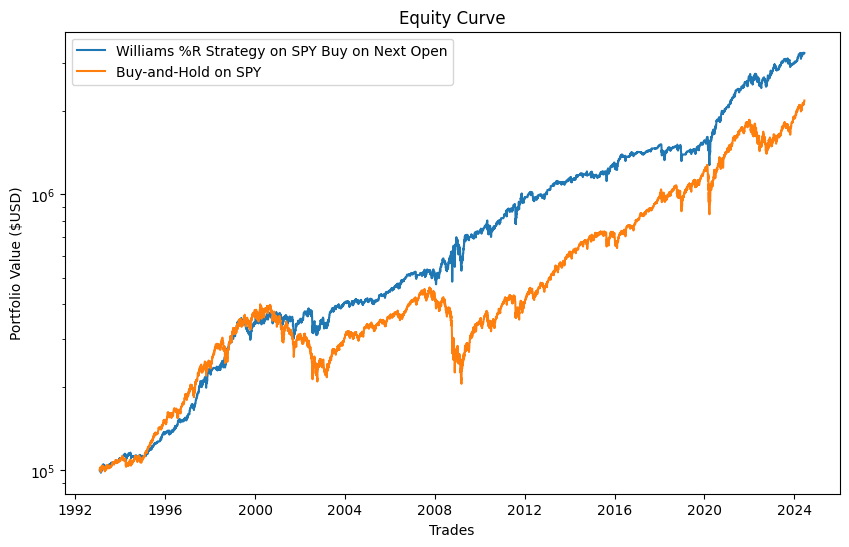

In [73]:
# Some of this code was assisted by Codeium autocomplete
strategy = results[0]
dates = strategy.dates

spy_rows = spy.loc[spy.index.isin(np.array(dates, dtype='datetime64[ns]'))]
spy_rows = spy.reindex(dates, method='ffill')
shares = start_cash / spy.iloc[0]["Adj Close"]
buy_and_hold_spy = [shares * row["Adj Close"] for _, row in spy_rows.iterrows()]

plt.figure(figsize=(10, 6))
plt.plot(dates, strategy.equity_curve, label='Williams %R Strategy on SPY Buy on Next Open')
plt.plot(dates, buy_and_hold_spy, label='Buy-and-Hold on SPY')

# Set the y-ticks and labels
plt.yticks(y_ticks, y_labels)
plt.title('Equity Curve')
plt.xlabel('Trades')
plt.ylabel('Portfolio Value ($USD)')

plt.yscale('log')
plt.legend()
plt.show()

## Backtesting on FOREX

In [103]:
# Get data
import os
import requests
import time
import os.path

# List of forex symbols to query
to_symbols = ['EUR', 'GBP', 'JPY', 'AUD', 'CAD']
symbol = 'USD'

# Retrieve API key from environment variable
api_key = os.environ.get('ALPHA_VANTAGE_KEY')
if not api_key:
    raise ValueError('API key not found in environment variable ALPHA_VANTAGE_KEY')

# Base URL for the API endpoint
base_url = 'https://www.alphavantage.co/query'

# Loop over each symbol and fetch data
for to_symbol in to_symbols:
    filename = f'Data/forex_{symbol}_{to_symbol}_60min.csv'
    
    # Check if the data file already exists
    if os.path.exists(filename):
        print(f"Data file {filename} already exists. Skipping API call.")
        continue
    
    # Parameters for the API request
    params = {
        'function': 'FX_INTRADAY',
        'from_symbol': symbol,
        'to_symbol': to_symbol,
        'outputsize': 'full',  # Fetch full-length data
        'datatype': 'csv',     # Get data in CSV format
        'interval': '60min',    # 60 minute intervals
        'apikey': api_key
    }
    
    print(f"Requesting data for {symbol}/{to_symbol}...")
    response = requests.get(base_url, params=params)
    
    # Check if the request was successful
    if response.status_code == 200:
        with open(filename, 'w') as f:
            f.write(response.text)
        print(f"Data for {symbol}/{to_symbol} saved to {filename}")
    else:
        print(f"Error fetching data for {symbol}/{to_symbol}: {response.status_code}")
    
    # Sleep to respect API rate limits (5 requests per minute)
    time.sleep(1)


Requesting data for USD/EUR...
Data for USD/EUR saved to Data/forex_USD_EUR_60min.csv
Requesting data for USD/GBP...
Data for USD/GBP saved to Data/forex_USD_GBP_60min.csv
Requesting data for USD/JPY...
Data for USD/JPY saved to Data/forex_USD_JPY_60min.csv
Requesting data for USD/AUD...
Data for USD/AUD saved to Data/forex_USD_AUD_60min.csv
Requesting data for USD/CAD...
Data for USD/CAD saved to Data/forex_USD_CAD_60min.csv


In [155]:
# Path to your CSV file
datafiles = ['Data/forex_USD_EUR_60min_reversed.csv', 'Data/forex_USD_GBP_60min_reversed.csv', 'Data/forex_USD_JPY_60min_reversed.csv', 'Data/forex_USD_AUD_60min_reversed.csv', 'Data/forex_USD_CAD_60min_reversed.csv']
all_results = {}
for datafile in datafiles:
    cerebro = bt.Cerebro(cheat_on_open=True)
    # Create a Data Feed
    data = bt.feeds.GenericCSVData(
        dataname=datafile,
        datetime=0,
        timestamp=0,  # The timestamp column is at index 0
        dtformat=('%Y-%m-%d %H:%M:%S'),
        time=-1,  # No separate time column
        open=1,
        high=2,
        low=3,
        close=4,
        volume=-1,  # No volume column
        openinterest=-1,  # No open interest column
        timeframe=bt.TimeFrame.Minutes,
        compression=60
    )

    cerebro.adddata(data)

    # Add the WilliamsR strategy
    cerebro.addstrategy(WilliamsRStrategy, period=50, upperband=-12.5, lowerband=-72.5, cheat_on_open=True)
    cerebro.broker.setcommission(commission=0.0)
    cerebro.broker.set_coc(False)

    # Set initial capital and broker settings
    # This code was assited using Codeium autocomplete
    start_cash = 100000.0000
    cerebro.broker.setcash(start_cash)
    cerebro.addsizer(bt.sizers.PercentSizer, percents=100)
    cerebro.addanalyzer(btanalyzers.TradeAnalyzer, _name="trade_stats")
    cerebro.addanalyzer(btanalyzers.DrawDown, _name="drawdown")
    cerebro.addanalyzer(btanalyzers.Returns, _name="returns")

    # Print starting capital
    print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

    # Run the strategy
    results = cerebro.run()

    # Print final capital
    print('Final Portfolio Value: %.2f\n' % cerebro.broker.getvalue())
    all_results[datafile[11:18]] = results[0]


Starting Portfolio Value: 100000.00
2024-08-02, BUY EXECUTED, 0.92
2024-08-02, SELL EXECUTED, 0.92
2024-08-05, BUY EXECUTED, 0.92
2024-08-05, SELL EXECUTED, 0.92
2024-08-05, BUY EXECUTED, 0.91
2024-08-05, SELL EXECUTED, 0.91
2024-08-05, BUY EXECUTED, 0.91
2024-08-05, SELL EXECUTED, 0.91
2024-08-06, BUY EXECUTED, 0.91
2024-08-06, SELL EXECUTED, 0.91
2024-08-06, BUY EXECUTED, 0.92
2024-08-06, SELL EXECUTED, 0.91
2024-08-07, BUY EXECUTED, 0.91
2024-08-07, SELL EXECUTED, 0.92
2024-08-07, BUY EXECUTED, 0.92
2024-08-07, SELL EXECUTED, 0.92
2024-08-07, BUY EXECUTED, 0.92
2024-08-07, SELL EXECUTED, 0.92
2024-08-08, BUY EXECUTED, 0.91
2024-08-08, SELL EXECUTED, 0.91
2024-08-08, BUY EXECUTED, 0.91
2024-08-08, SELL EXECUTED, 0.91
2024-08-08, BUY EXECUTED, 0.91
2024-08-08, SELL EXECUTED, 0.92
2024-08-08, BUY EXECUTED, 0.92
2024-08-09, SELL EXECUTED, 0.92
2024-08-09, BUY EXECUTED, 0.92
2024-08-09, SELL EXECUTED, 0.92
2024-08-09, BUY EXECUTED, 0.91
2024-08-09, SELL EXECUTED, 0.92
2024-08-09, BUY EXE

In [157]:
def convert_date(serial_number):
  # Separate the integer and fractional parts
  ordinal_number = int(serial_number)
  fractional_day = serial_number - ordinal_number

  # Convert the ordinal number to a date
  date_part = datetime.fromordinal(ordinal_number)

  # Convert the fractional day to a time delta
  time_part = timedelta(days=fractional_day)

  # Combine the date and time parts
  datetime_value = date_part + time_part
  return datetime_value


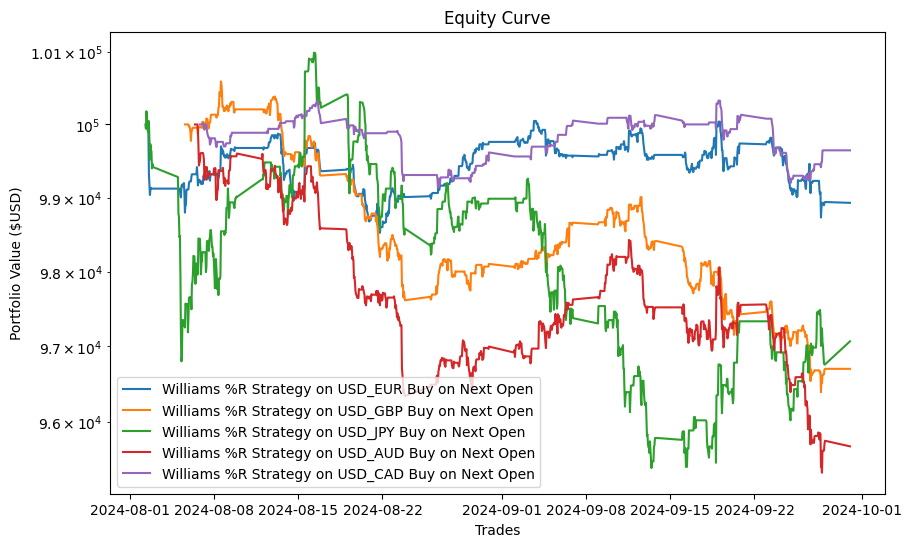

In [158]:
# Some of this code was assisted by Codeium autocomplete
plt.figure(figsize=(10, 6))
for strategy in all_results:
  dates = pd.read_csv(f'Data/forex_{strategy}_60min_reversed.csv')
  dates["timestamp"] = pd.to_datetime(dates["timestamp"])
  dates = dates["timestamp"][1:]
  dates = [convert_date(date) for date in all_results[strategy].dates]
  plt.plot(dates, all_results[strategy].equity_curve, label=f'Williams %R Strategy on {strategy} Buy on Next Open')

# Set the y-ticks and labels
plt.title('Equity Curve')
plt.xlabel('Trades')
plt.ylabel('Portfolio Value ($USD)')

plt.yscale('log')
plt.legend()
plt.show()

## Forex Optimization

In [170]:
periods = list(range(2,51))
upperbands = list(range(-10,-35,-5))
lowerbands = list(range(-70,-95,-5))

cerebro = bt.Cerebro(cheat_on_open=True)
datafiles = ['Data/forex_USD_EUR_60min_reversed.csv', 'Data/forex_USD_GBP_60min_reversed.csv', 'Data/forex_USD_JPY_60min_reversed.csv', 'Data/forex_USD_AUD_60min_reversed.csv', 'Data/forex_USD_CAD_60min_reversed.csv']
opt_results = {}
for datafile in datafiles:
  cerebro = bt.Cerebro(cheat_on_open=True)
  # Create a Data Feed
  data = bt.feeds.GenericCSVData(
      dataname=datafile,
      datetime=0,
      timestamp=0,  # The timestamp column is at index 0
      dtformat=('%Y-%m-%d %H:%M:%S'),
      time=-1,  # No separate time column
      open=1,
      high=2,
      low=3,
      close=4,
      volume=-1,  # No volume column
      openinterest=-1,  # No open interest column
      timeframe=bt.TimeFrame.Minutes,
      compression=60
  )

  cerebro.adddata(data)

  # Add the WilliamsR strategy
  cerebro.optstrategy(WilliamsRStrategy, period=periods, upperband=upperbands, lowerband=lowerbands, cheat_on_open=True)

  # Set initial capital and broker settings
  # This code was assited using Codeium autocomplete
  start_cash = 100000.0
  cerebro.broker.setcash(start_cash)
  cerebro.addsizer(bt.sizers.AllInSizer)
  cerebro.addanalyzer(btanalyzers.TradeAnalyzer, _name="trade_stats")
  cerebro.addanalyzer(btanalyzers.DrawDown, _name="drawdown")
  cerebro.addanalyzer(btanalyzers.Returns, _name="returns")

  runs = cerebro.run(maxcpus=1)
  opt_results[datafile[11:18]] = runs

2024-08-02, BUY EXECUTED, 0.92
2024-08-02, SELL EXECUTED, 0.92
2024-08-05, BUY EXECUTED, 0.92
2024-08-05, SELL EXECUTED, 0.92
2024-08-05, BUY EXECUTED, 0.91
2024-08-05, SELL EXECUTED, 0.91
2024-08-05, BUY EXECUTED, 0.91
2024-08-06, SELL EXECUTED, 0.91
2024-08-06, BUY EXECUTED, 0.91
2024-08-06, SELL EXECUTED, 0.91
2024-08-06, BUY EXECUTED, 0.92
2024-08-06, SELL EXECUTED, 0.91
2024-08-07, BUY EXECUTED, 0.91
2024-08-07, SELL EXECUTED, 0.92
2024-08-07, BUY EXECUTED, 0.92
2024-08-07, SELL EXECUTED, 0.92
2024-08-07, BUY EXECUTED, 0.92
2024-08-07, SELL EXECUTED, 0.92
2024-08-08, BUY EXECUTED, 0.91
2024-08-08, SELL EXECUTED, 0.91
2024-08-08, BUY EXECUTED, 0.91
2024-08-08, SELL EXECUTED, 0.91
2024-08-08, BUY EXECUTED, 0.91
2024-08-08, SELL EXECUTED, 0.92
2024-08-08, BUY EXECUTED, 0.92
2024-08-09, SELL EXECUTED, 0.92
2024-08-09, BUY EXECUTED, 0.92
2024-08-09, SELL EXECUTED, 0.92
2024-08-09, BUY EXECUTED, 0.91
2024-08-09, SELL EXECUTED, 0.92
2024-08-09, BUY EXECUTED, 0.92
2024-08-09, SELL EXECUTE

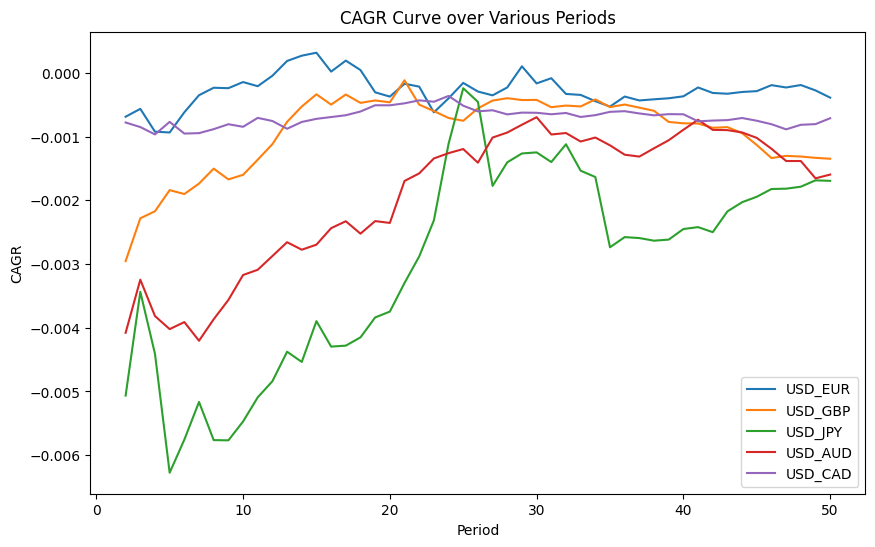

In [172]:
plt.figure(figsize=(10, 6))
for strat_name in opt_results:
  runs = opt_results[strat_name]
  avg_profits = []
  for period in list(range(2,51)):
    profit = [strat[0].analyzers.returns.get_analysis()['rnorm']*100 for strat in runs if strat[0].params.period == period]
    avg_profits.append(sum(profit)/len(profit))
  plt.plot(list(range(2,51)), avg_profits, label=strat_name)
plt.title('CAGR Curve over Various Periods')
plt.xlabel('Period')
plt.ylabel('CAGR')
plt.legend()
plt.show()

USD_EUR
Avg Profit:  -0.0004352347898447996


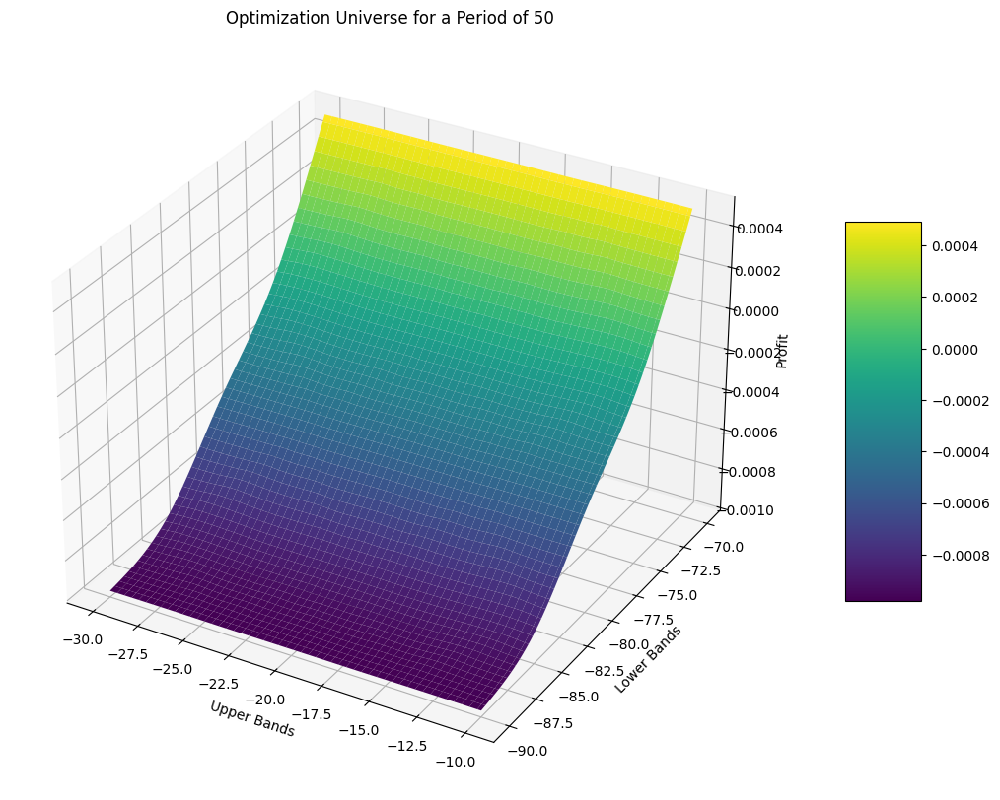

USD_GBP
Avg Profit:  -0.0012693997044855132


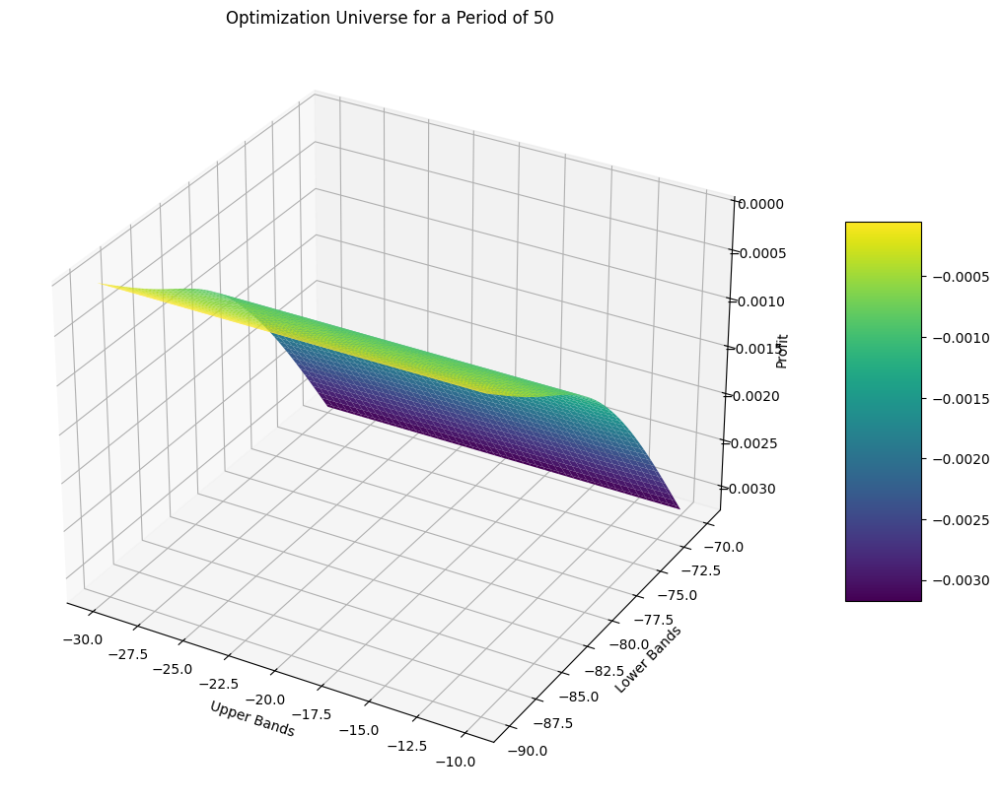

USD_JPY
Avg Profit:  -0.0019102850973307319


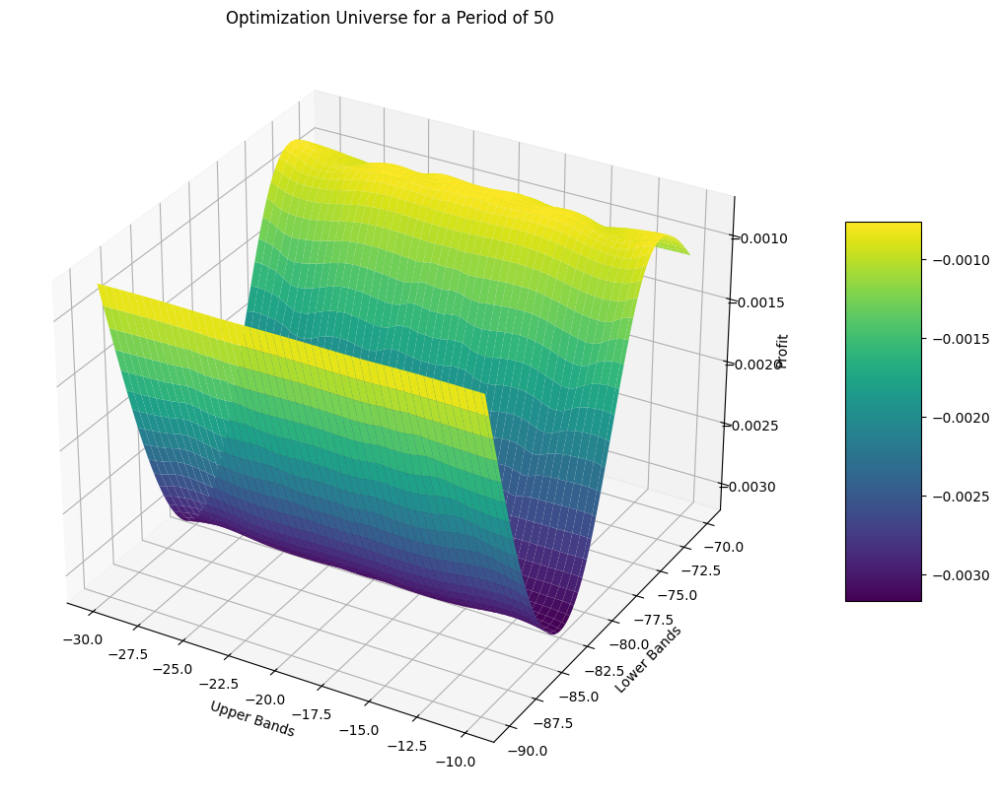

USD_AUD
Avg Profit:  -0.001600212562082729


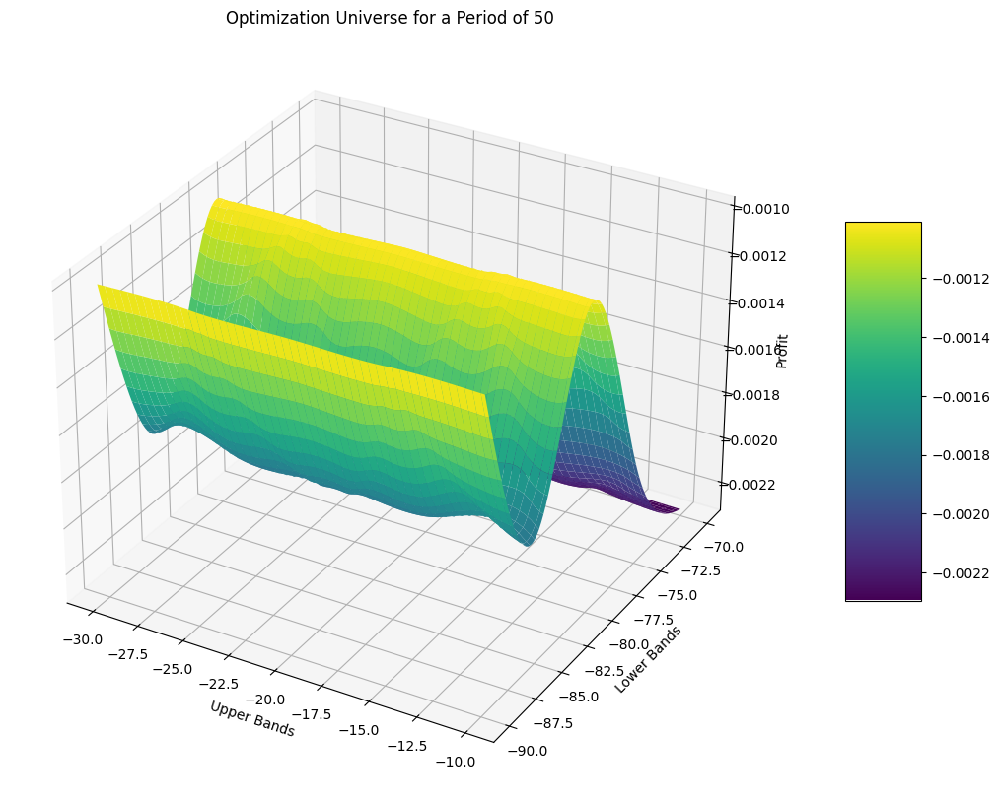

USD_CAD
Avg Profit:  -0.0006731656765340994


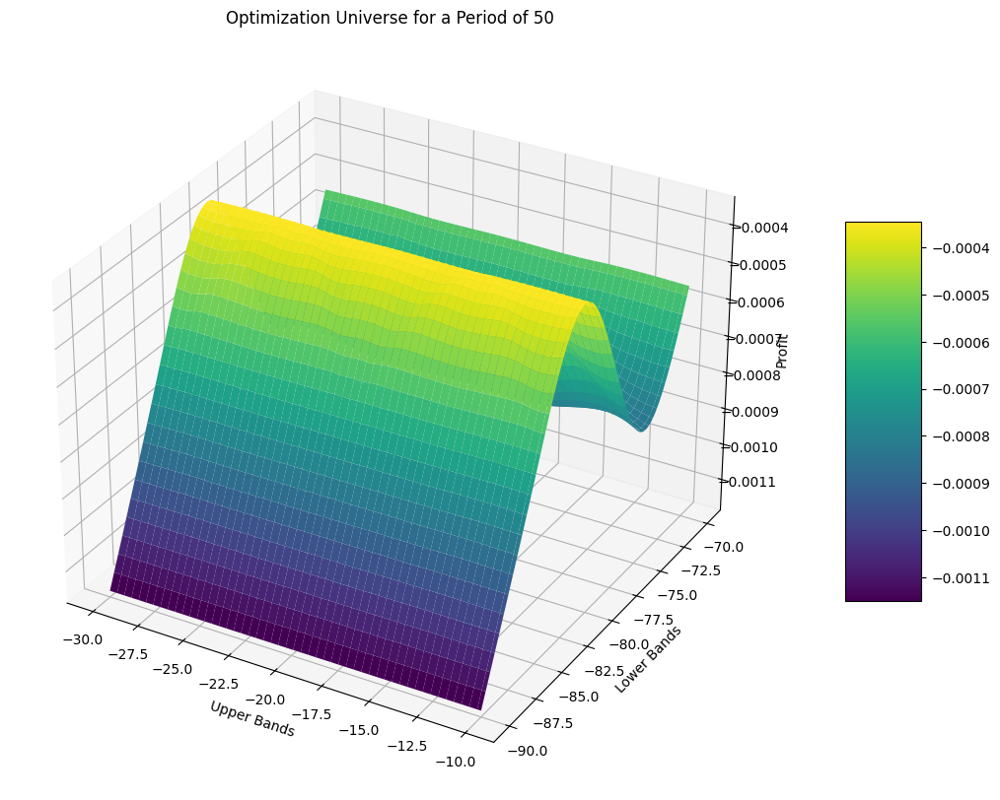

In [174]:
period = 50
for run_name in opt_results:
  runs = opt_results[run_name]
  upperbands = [strat[0].params.upperband for strat in runs if strat[0].params.period == period]
  lowerbands = [strat[0].params.lowerband for strat in runs if strat[0].params.period == period]
  profit = [strat[0].analyzers.returns.get_analysis()['rnorm']*100 for strat in runs if strat[0].params.period == period]
  print(run_name)
  plot_op_uni(upperbands, lowerbands, profit, period)